In [48]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
import scipy.ndimage.filters as filters
import pm

from IPython.core.pylabtools import figsize
figsize(20, 20)

def plot(*args):
    count = len(args)
    fig, ax = plt.subplots(1,count)
    fig.set_figheight(5)
    fig.set_figwidth(15)
    if count==1:
        ax.imshow(args[0], cmap="gray")
    else:
        for i in range(len(ax)):
            ax[i].imshow(args[i], cmap="gray")
    plt.show()

In [ ]:
def harris(image, n=3, k=0.05):
    sobel_x = cv2.Sobel(image, cv2.CV_32F, 1, 0, n)
    sobel_y = cv2.Sobel(image, cv2.CV_32F, 0 , 1, n)

    ixx = sobel_x * sobel_x
    ixy = sobel_x * sobel_y
    iyy = sobel_y * sobel_y

    ixx_gaus = cv2.GaussianBlur(ixx, (n,n), 1)
    ixy_gaus = cv2.GaussianBlur(ixy, (n,n), 1)
    iyy_gaus = cv2.GaussianBlur(iyy, (n,n), 1)

    trace = ixx_gaus + ixy_gaus
    det = ixx_gaus*iyy_gaus - ixy_gaus**2
    H = det - k*trace**2

    return (H - np.min(H)) / (np.max(H) - np.min(H))

def find_max(image, size, threshold): #size - maximum filter mask size
    data_max = filters.maximum_filter(image, size)
    maxima = (image == data_max)
    diff = image > threshold
    maxima[diff == 0] = 0
    return np.nonzero(maxima)

def plot_maxes(image, maxes):
    plt.imshow(image, cmap="gray")
    plt.plot(maxes[1], maxes[0], "*", color="red")
    plt.show()


image_1 = cv2.imread("fontanna1.jpg", cv2.IMREAD_GRAYSCALE)
image_2 = cv2.imread("fontanna2.jpg", cv2.IMREAD_GRAYSCALE)
image_3 = cv2.imread("budynek1.jpg", cv2.IMREAD_GRAYSCALE)
image_4 = cv2.imread("budynek2.jpg", cv2.IMREAD_GRAYSCALE)

for image in [image_1, image_2, image_3, image_4]:
    h = harris(image)
    maxes = find_max(h, 7, 0.5)
    plot_maxes(image, maxes)


In [ ]:
def descrption(image, points, size=3):
    Y, X = image.shape
    points = list(filter(lambda pt: pt[0] >= size and pt[0] < Y - size and pt[1]>= size and pt[1] < X - size, zip(points[0], points[1])))
    descriptions = []

    for point in points:
        point_description = image[point[0] - size: point[0] + size + 1, point[1] - size: point[1] + size + 1]
        descriptions.append(point_description.flatten())

    return list(zip(points, descriptions))

def description_updated(image, points, size=3):
    Y, X = image.shape
    points = list(filter(lambda pt: pt[0] >= size and pt[0] < Y - size and pt[1]>= size and pt[1] < X - size, zip(points[0], points[1])))
    descriptions = []

    for point in points:
        point_description = image[point[0] - size: point[0] + size + 1, point[1] - size: point[1] + size + 1]
        point_description = point_description.flatten()

        mean = np.mean(point_description)
        std = np.std(point_description)
        descriptions.append((point_description - mean) / std)

    return list(zip(points, descriptions))


def compare_descriptions(point_descs_1, point_descs_2, n=20):
    res = []

    for point_1, desc_1 in point_descs_1:
        min_dist = float("inf")
        best_one = None
        for point_2, desc_2 in point_descs_2:
            dist = sum(abs(desc_1 - desc_2))

            if dist < min_dist:
                min_dist = dist
                best_one = [point_1, point_2, dist]

        res.append(best_one)

    res.sort(key=lambda x: x[2])
    return res[:n]


def do_all(image_name_1, image_name_2):
    image_1 = cv2.imread(image_name_1, cv2.IMREAD_GRAYSCALE)
    image_2 = cv2.imread(image_name_2, cv2.IMREAD_GRAYSCALE)
    
    h_1 = harris(image_1)
    h_2 = harris(image_2)
    
    maxes_1 = find_max(h_1, 7, 0.5)
    maxes_2 = find_max(h_2, 7, 0.5)
    
    descrption_1 = descrption(image_1, maxes_1)
    descrption_2 = descrption(image_2, maxes_2)
    
    closest_points = compare_descriptions(descrption_1, descrption_2)
    
    pm.plot_matches(image_1, image_2, closest_points)

do_all("eiffel1.jpg", "eiffel2.jpg")
do_all("budynek1.jpg", "budynek2.jpg")
do_all("fontanna1.jpg", "fontanna2.jpg")

C:\Users\ogsimp\AppData\Local\Temp\ipykernel_2456\4202757160.py:20: DeprecationWarning: Please use `maximum_filter` from the `scipy.ndimage` namespace, the `scipy.ndimage.filters` namespace is deprecated.
  data_max = filters.maximum_filter(image, size)


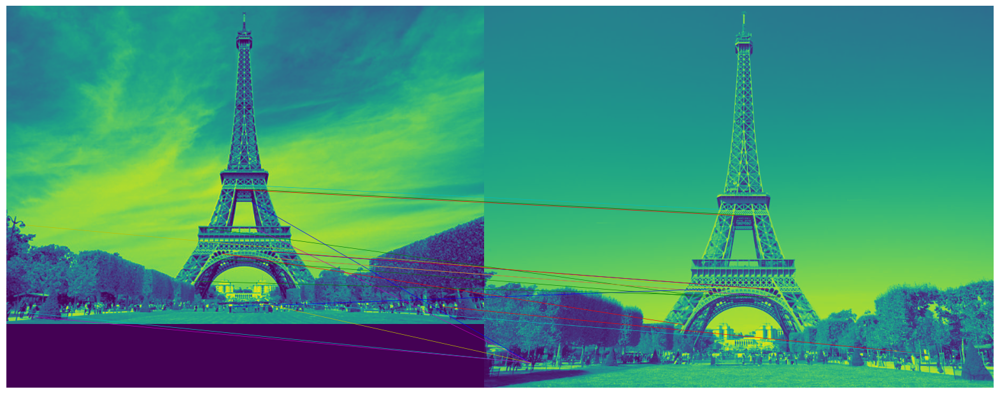

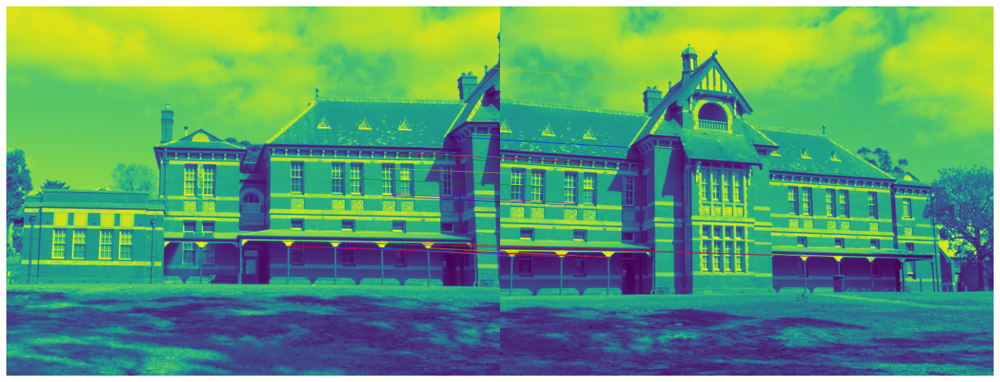

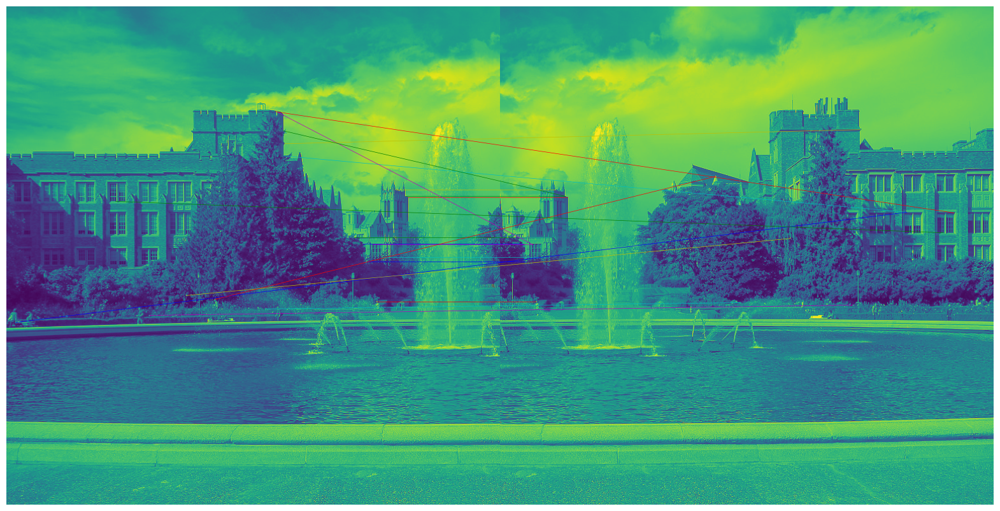

In [10]:
def do_all_2(image_name_1, image_name_2):
    image_1 = cv2.imread(image_name_1, cv2.IMREAD_GRAYSCALE)
    image_2 = cv2.imread(image_name_2, cv2.IMREAD_GRAYSCALE)
    
    h_1 = harris(image_1)
    h_2 = harris(image_2)
    
    maxes_1 = find_max(h_1, 7, 0.5)
    maxes_2 = find_max(h_2, 7, 0.5)
    
    descrption_1 = description_updated(image_1, maxes_1)
    descrption_2 = description_updated(image_2, maxes_2)
    
    closest_points = compare_descriptions(descrption_1, descrption_2)
    
    pm.plot_matches(image_1, image_2, closest_points)

do_all_2("eiffel1.jpg", "eiffel2.jpg")
do_all_2("budynek1.jpg", "budynek2.jpg")
do_all_2("fontanna1.jpg", "fontanna2.jpg")

# CZESC 2 - ORB(FAST + BRIEF)

In [41]:
def has_consequent_count(circle, center, threshold=60, n=9):
    lower_count = 0
    higher_count = 0
    for val in circle:
        if val > center + threshold:
            higher_count += 1
            lower_count = 0
            if higher_count >= n:
                return True
        if val < center - threshold:
            lower_count += 1
            higher_count = 0
            if lower_count >= n:
                return True
    return False


def fast(image):
    Y, X = image.shape
    h = harris(image, n=7)
    s=31
    res = []
    for y in range(s, Y - s):
        for x in range(s, X - s):
            center = image[y,x]

            circle = [image[y+3,x-1], image[y+3,x], image[y+3,x+1],
                      image[y+2,x+2],
                      image[y+1,x+3], image[y,x+3], image[y-1,x+3],
                      image[y-2,x+2],
                      image[y-3,x+1], image[y-3,x], image[y-3,x-1],
                      image[y-2,x-2],
                      image[y-1, x-3], image[y,x-3], image[y+1,x-3],
                      image[y+2,x-2]]
            if has_consequent_count(circle, center, 40):
                res.append(((y,x), h[y,x]))

    return res         
                
            
# image = cv2.imread("eiffel2.jpg", cv2.IMREAD_GRAYSCALE)
# fast_points = fast(image)
# points = [f[0] for f in fast_points]
# plt.imshow(image)
# plt.plot([p[1] for p in points], [p[0] for p in points], "*", color="red")
# plt.show()

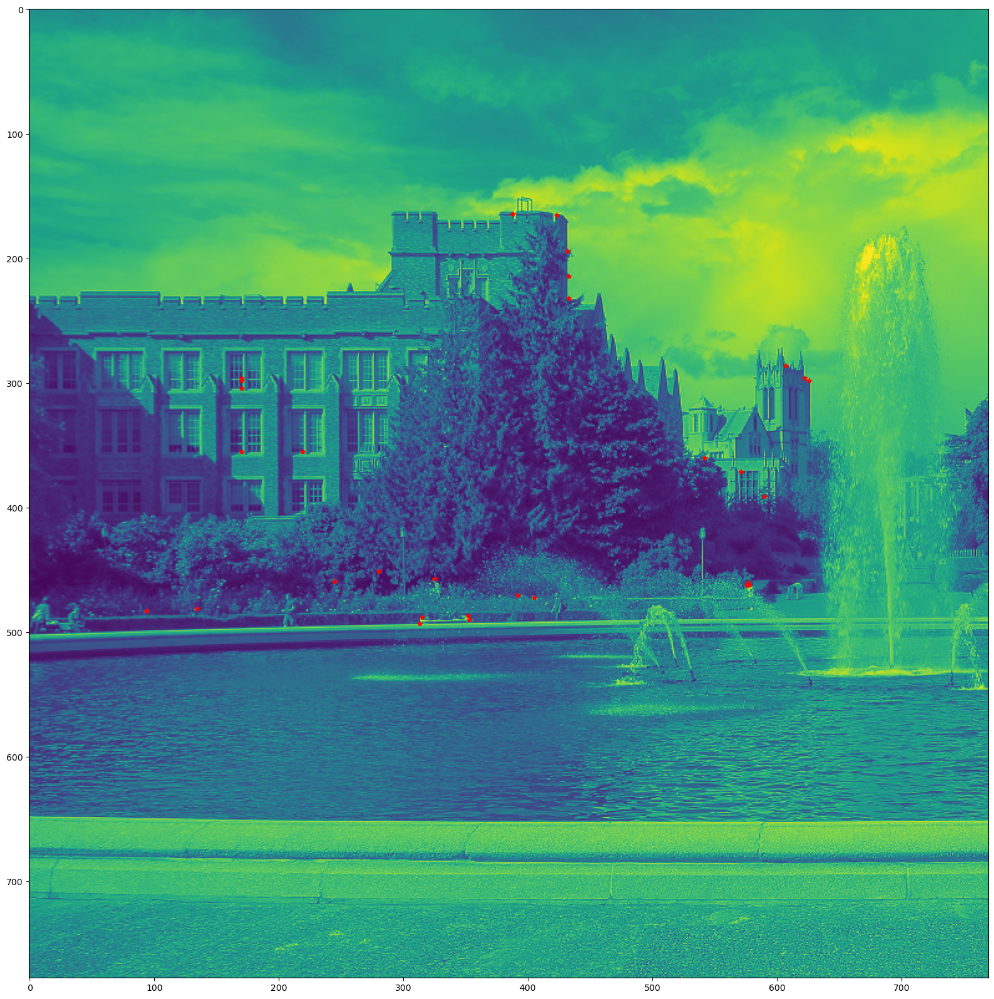

In [42]:
def non_maximum_suppression(points):
    points.sort(key = lambda x: x[1], reverse=True)
    result = []
    for point in points:
        y, x = point[0]
        # check if all of the points in the result are far enough from the current point (no pixels in 3x3 square around)
        is_far_enough = True
        for r in result:
            y1, x1 = r[0]
            if abs(y - y1) <= 1 and abs(x - x1) <= 1:
                if point[1] < r[1]:
                    is_far_enough = False
                else:
                    result.remove(r)
                break
        if is_far_enough:
            result.append(point)
    return result

image = cv2.imread("fontanna1.jpg", cv2.IMREAD_GRAYSCALE)
fast_points = fast(image)
fast_points = non_maximum_suppression(fast_points)
fast_points = fast_points[:30]
points = [f[0] for f in fast_points]
plt.imshow(image)
plt.plot([p[1] for p in points], [p[0] for p in points], "*", color="red")
plt.show()

In [43]:
def calculate_moment(points, image, size=3):
    C, phi = [], []
    for point in points:
        y, x = point[0]
        window = image[y-size:y+size+1, x-size:x+size+1]
        m00 = np.sum(window)
        m01 = 0
        m10 = 0
        for i in range(-size, size + 1):
            for j in range(-size, size + 1):
                m01 += i * window[i, j]
                m10 += j * window[i, j]
    
        C.append((m01/m00, m10/m00))
        phi.append(np.arctan2(m01, m10))
            
    return [(C[i], phi[i]) for i in range(len(C))]


def find_centroids(points, image):
    res_c, res_angle = [], []
    for point in points:
        y, x = point[0]

        m00, m01, m10 = 0, 0, 0

        for i in range(y-3, y+3+1):
            for j in range(x-3, x+3+1):
                dy = y - i
                dx = x - j
        
                if dx*dx + dy*dy <= 3**2:
                    m00 += image[i, j]
                    m01 += dy * image[i, j]
                    m10 += dx * image[i, j]

        c = (m10/m00, m01/m00)
        angle = np.arctan2(m01,m10)
        res_c.append(c)
        res_angle.append(angle)
    return [(res_c[i], res_angle[i]) for i in range(len(res_c))]


In [44]:
def brief(image, points, centroids):
    file = open("orb_descriptor_positions.txt", "r")
    res = []

    for i in range(len(points)):
        point = points[i]
        point_res = []
        centroid = centroids[i]
        angle = centroid[1]

        y,x = point[0]
        context = image[y-15:y+16, x-15:x+16]
        # print(context.shape, point)
        context = cv2.GaussianBlur(context, (5,5), 0)
        
        for line in file:
            values = [float(x) for x in line.split()]
            start_y, start_x = tuple(values[:2])
            end_y, end_x = tuple(values[2:])
            start_x, start_y, end_x, end_y = int(start_x), int(start_y), int(end_x), int(end_y)
            
            start_y_r = int(np.sin(angle) + start_y + np.cos(angle) * start_x)
            start_x_r = int(np.cos(angle) + start_x - np.sin(angle) * start_y)

            end_y_r = int(np.sin(angle) + end_y + np.cos(angle) * end_x)
            end_x_r = int(np.cos(angle) + end_x - np.sin(angle) * end_y)
            
            
            
            if context[start_y_r, start_x_r] < context[end_y_r, end_x_r]:
                point_res.append(1)
            else:
                point_res.append(0)
            

        res.append(((y,x), point_res))

    return res

In [45]:
def hamming(vals_1, vals_2):
    res = 0
    for i in range(len(vals_1)):
        res += 1 if vals_1[i] != vals_2[i] else 0

    return res

def join_brief_points(points_1, points_2):
    res = []
    for i in range(len(points_1)):
        point_1, scores_1 = points_1[i]
        min_dist = float("inf")
        best_point = None
        for j in range(len(points_2)):
            point_2, scores_2 = points_2[i]
            dist = hamming(scores_1, scores_2)
            if dist < min_dist:
                min_dist = dist
                best_point = point_2

        res.append([point_1, best_point, min_dist])

    return res

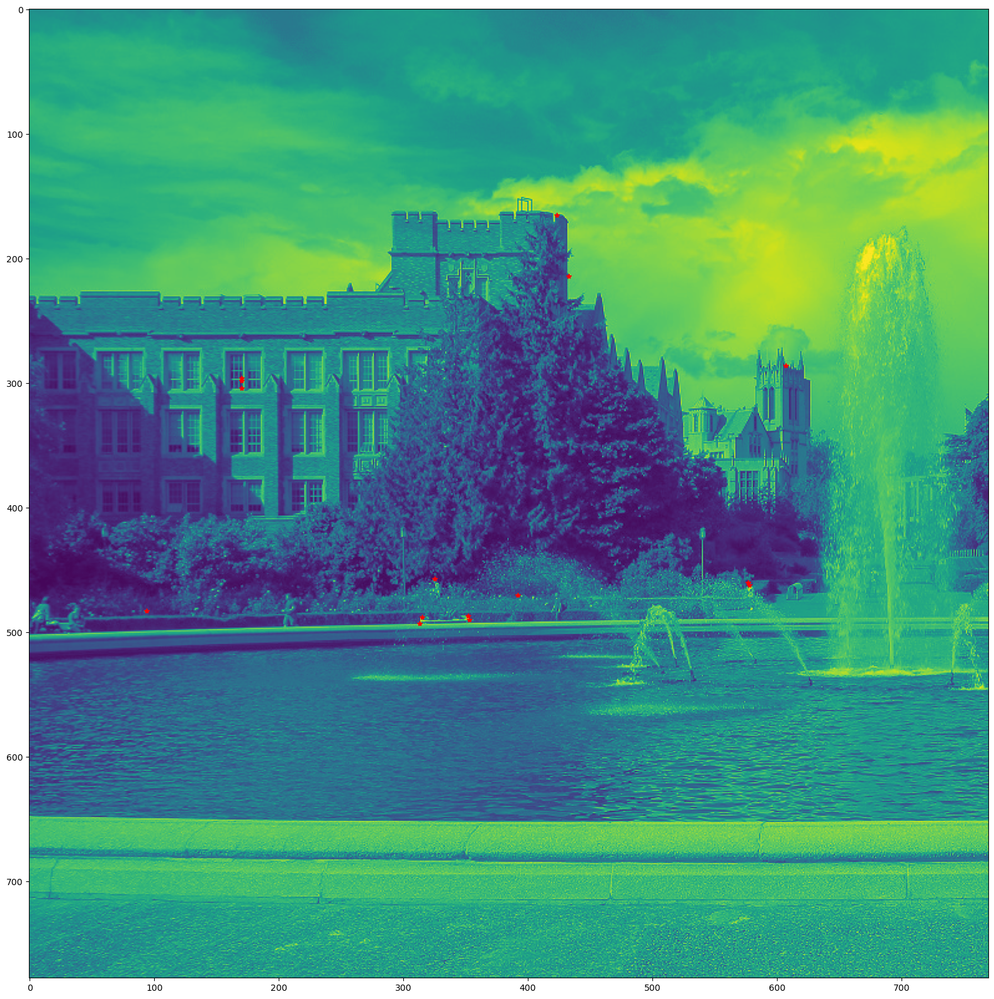

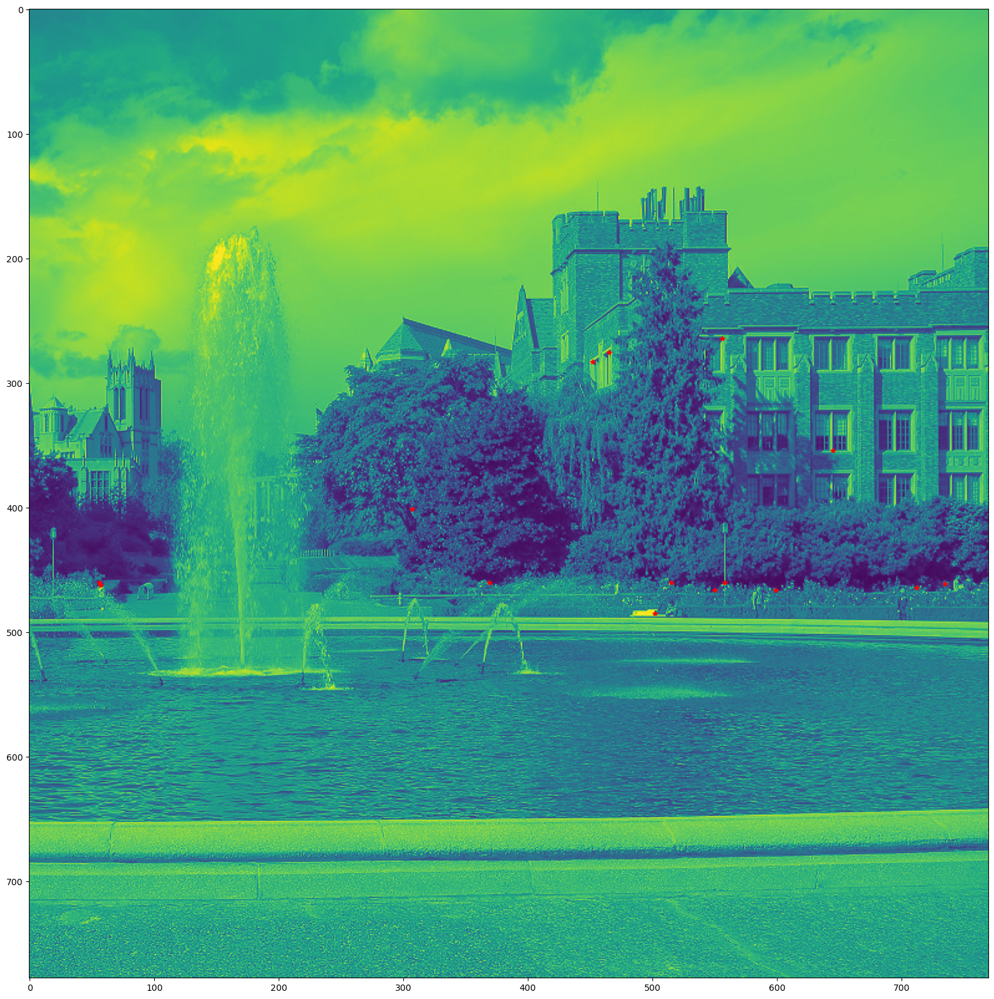

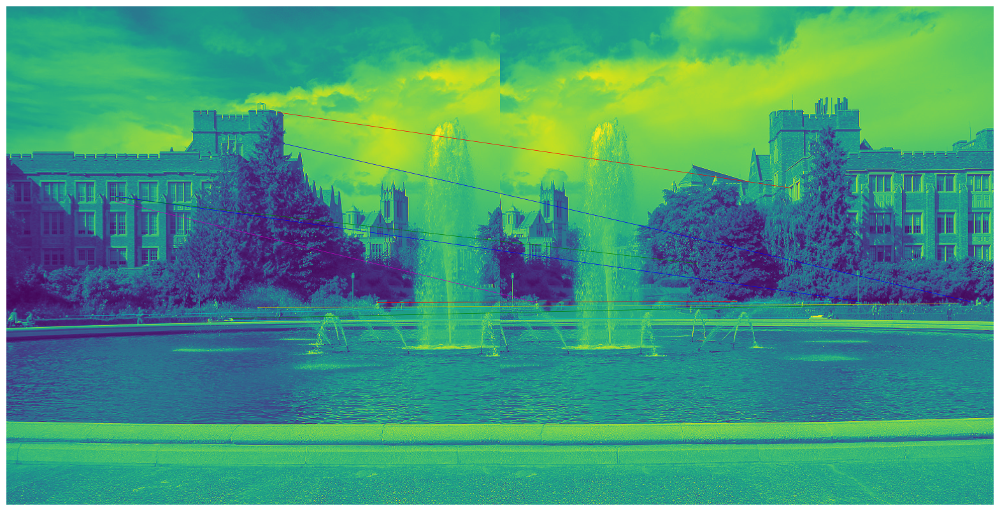

In [47]:
def do_all_orb():
    image_1 = cv2.imread("fontanna1.jpg", cv2.IMREAD_GRAYSCALE)
    fast_points_1 = fast(image_1)
    fast_points_1 = non_maximum_suppression(fast_points_1)
    fast_points_1.sort(key=lambda x: x[1], reverse=True)
    fast_points_1 = fast_points_1[:15]

    centroids_1 = find_centroids(fast_points_1, image_1)
    brief_1 = brief(image_1, fast_points_1, centroids_1)


    image_2 = cv2.imread("fontanna2.jpg", cv2.IMREAD_GRAYSCALE)
    fast_points_2 = fast(image_2)
    fast_points_2 = non_maximum_suppression(fast_points_2)
    fast_points_2.sort(key=lambda x: x[1], reverse=True)
    fast_points_2 = fast_points_2[:15]
    
    centroids_2 = find_centroids(fast_points_2, image_2)
    brief_2 = brief(image_2, fast_points_2, centroids_2)


    plt.imshow(image_1)
    plt.plot([p[0][1] for p in fast_points_1], [p[0][0] for p in fast_points_1], "*", color="red")
    plt.show()

    plt.imshow(image_2)
    plt.plot([p[0][1] for p in fast_points_2], [p[0][0] for p in fast_points_2], "*", color="red")
    plt.show()
    
    res = join_brief_points(brief_1, brief_2)
    res.sort(key=lambda x: x[2])
    res = res[:10]
    
    pm.plot_matches(image_1, image_2, res)

do_all_orb()

# 2 WERSJA

In [36]:
def has_consequent_count(circle, center, threshold, n=9):
    lower_count = 0
    higher_count = 0
    for val in circle:
        if val > center + threshold:
            higher_count += 1
            lower_count = 0
            if higher_count >= n:
                return True
        if val < center - threshold:
            lower_count += 1
            higher_count = 0
            if lower_count >= n:
                return True

    return False

def fast_2(img, threshold, size=7):
    n_points = 9
    Y, X = img.shape
    pts = [[-3, 0], [-3, 1], [-2, 2], [-1, 3], [0, 3], [1, 3], [2, 2], [3, 1], [3, 0], [3, -1], [2, -2], [1, -3], [0, -3], [-1, -3], [-2, -2], [-3, -1]]

    result = []

    point1 = pts[0]
    point2 = pts[4]
    point3 = pts[8]
    point4 = pts[12]

    def quick_check(x, y):
        pixel = img[y, x]
        lower_bound = pixel - threshold
        upper_bound = pixel + threshold

        pixel1 = img[y + point1[1], x + point1[0]]
        pixel2 = img[y + point2[1], x + point2[0]]
        pixel3 = img[y + point3[1], x + point3[0]]
        pixel4 = img[y + point4[1], x + point4[0]]

        low_count = 0
        high_count = 0
        for p in [pixel1, pixel2, pixel3, pixel4]:
            if p < lower_bound:
                low_count += 1
            elif p > upper_bound:
                high_count += 1
        return low_count >= 2 or high_count >= 2

    for y in range(size, Y - size):
        for x in range(size, X - size):
            if not quick_check(x, y):
                continue

            low_count = 0
            high_count = 0
            matched = False
            for p in pts:
                pixel = img[y + p[1], x + p[0]]
                if pixel < img[y, x] - threshold:
                    low_count += 1
                    high_count = 0
                elif pixel > img[y, x] + threshold:
                    high_count += 1
                    low_count = 0
                else:
                    high_count = 0
                    low_count = 0
                if low_count >= n_points or high_count >= n_points:
                    matched = True
                    break

            if not matched:
                for p in pts[:(n_points-1)]:
                    pixel = img[y + p[1], x + p[0]]
                    if pixel < img[y, x] - threshold:
                        low_count += 1
                        high_count = 0
                    elif pixel > img[y, x] + threshold:
                        high_count += 1
                        low_count = 0
                    else:
                        high_count = 0
                        low_count = 0
                    if low_count >= n_points or high_count >= n_points:
                        matched = True
            if not matched:
                continue
            H = harris(img[y-size:y+size+1, x-size:x+size+1], 7)
            pointHarris = H[size//2, size//2]
            result.append(((y, x), pointHarris))

    return result

# image = cv2.imread("fontanna1.jpg", cv2.IMREAD_GRAYSCALE)
# fast_points = fast_2(image, 120)
# 
# plt.imshow(image)
# plt.plot([p[0][1] for p in fast_points], [p[0][0] for p in fast_points], "*", color="red")
# plt.show()

[((-0.02314679167887489, -0.08174626428362144), -2.8656615358684414), ((-0.006460762685156004, -0.7570122912070596), -3.1330583062579143), ((-0.038813179230636534, -0.35777126099706746), -3.033529254347543), ((-0.4592178770949721, 0.6581005586592179), -0.6092431321236785), ((0.1724770642201835, 0.15706422018348623), 0.8321347060301043), ((0.13961550583044438, 0.264418531358336), 0.4858033418390224), ((0.340638216070742, 0.06132256824298347), 1.3926815237103611), ((-0.016894087069525665, 0.042884990253411304), -0.3752708228559573), ((0.1271809964263191, 0.5743115408871138), 0.217932454806236), ((-0.048768391469664406, -0.3127789717308646), -2.986918393474761)]


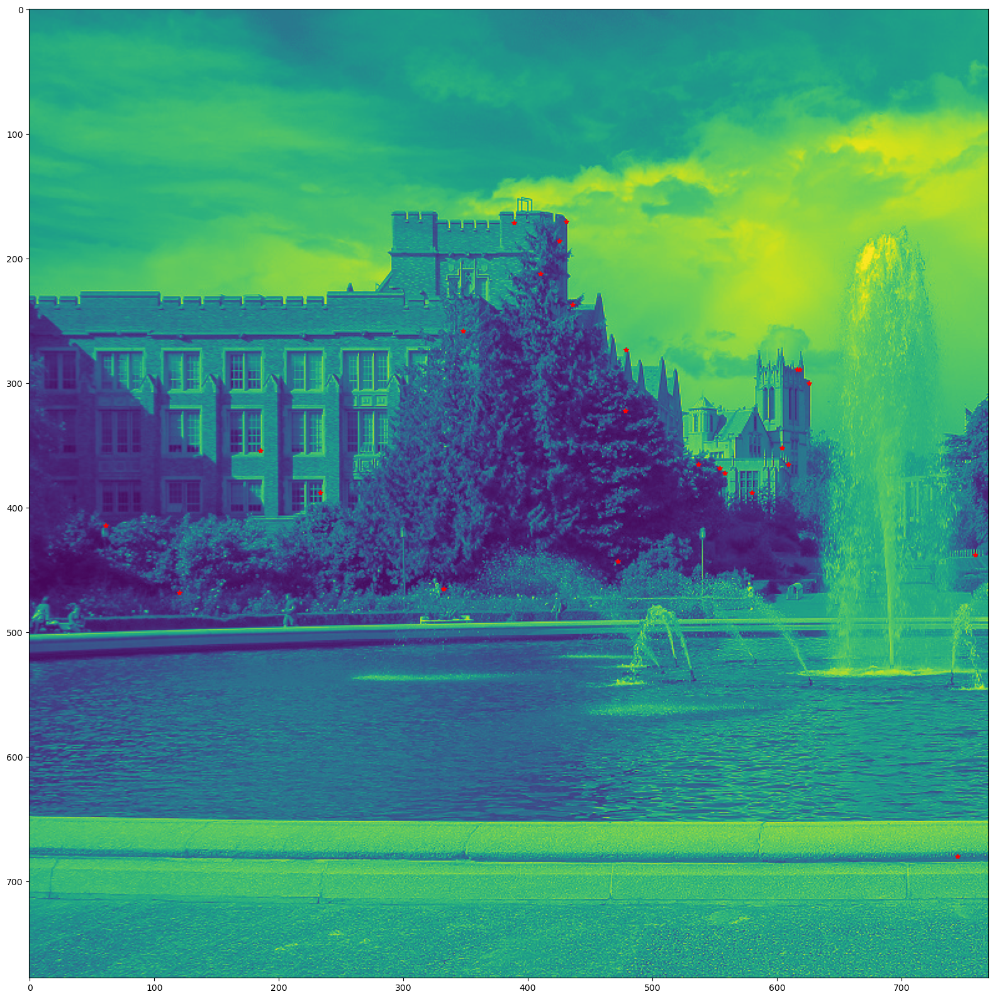

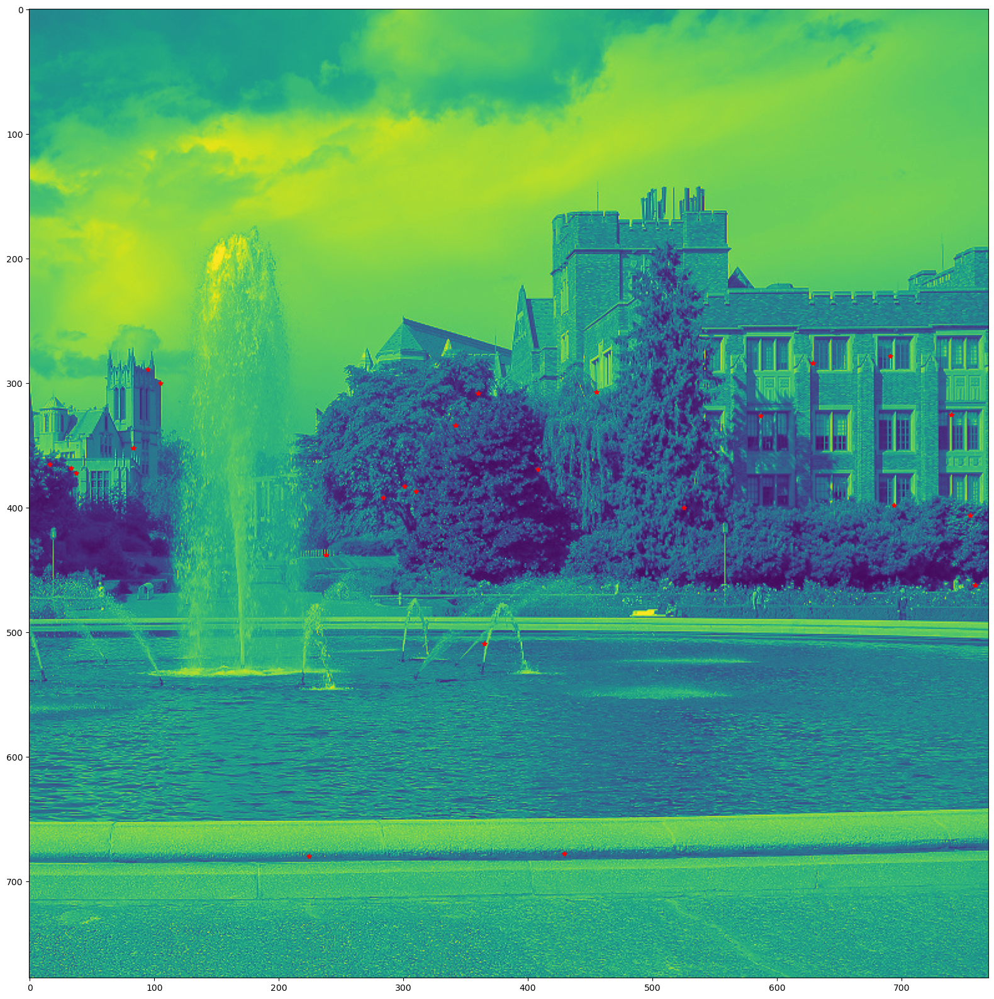

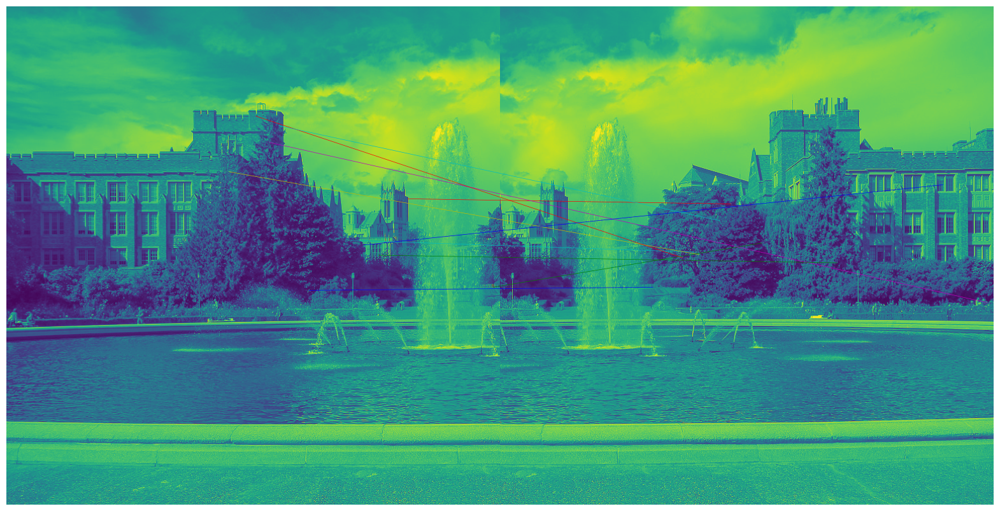

In [37]:
def do_all_orb_2():
    image_1 = cv2.imread("fontanna1.jpg", cv2.IMREAD_GRAYSCALE)
    fast_points_1 = fast_2(image_1, 90)
    fast_points_1 = non_maximum_suppression(fast_points_1)
    fast_points_1.sort(key=lambda x: x[1], reverse=True)
    fast_points_1 = fast_points_1[:25]

    centroids_1 = calculate_moment(fast_points_1, image_1)
    brief_1 = brief(image_1, fast_points_1, centroids_1)


    image_2 = cv2.imread("fontanna2.jpg", cv2.IMREAD_GRAYSCALE)
    fast_points_2 = fast_2(image_2, 90)
    fast_points_2 = non_maximum_suppression(fast_points_2)
    fast_points_2.sort(key=lambda x: x[1], reverse=True)
    fast_points_2 = fast_points_2[:25]

    centroids_2 = find_centroids(fast_points_2, image_2)
    brief_2 = brief(image_2, fast_points_2, centroids_2)


    plt.imshow(image_1)
    plt.plot([p[0][1] for p in fast_points_1], [p[0][0] for p in fast_points_1], "*", color="red")
    plt.show()

    plt.imshow(image_2)
    plt.plot([p[0][1] for p in fast_points_2], [p[0][0] for p in fast_points_2], "*", color="red")
    plt.show()

    res = join_brief_points(brief_1, brief_2)
    res.sort(key=lambda x: x[2])
    res = res[:10]

    pm.plot_matches(image_1, image_2, res)

do_all_orb_2()